<a href="https://colab.research.google.com/github/elyssa-qi/chicago-crime-rates/blob/main/URA_Project_(2004_2007).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error

In [ ]:
# Crimes - 2004 to 2007
data = pd.read_csv('/content/chicago-crime-rates/Crimes_-_2001_to_Present.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1371610 entries, 0 to 1371609
Data columns (total 22 columns):
 #   Column                Non-Null Count    Dtype  
---  ------                --------------    -----  
 0   ID                    1371610 non-null  int64  
 1   Case Number           1371610 non-null  object 
 2   Date                  1371610 non-null  object 
 3   Block                 1371610 non-null  object 
 4   IUCR                  1371610 non-null  object 
 5   Primary Type          1371610 non-null  object 
 6   Description           1371610 non-null  object 
 7   Location Description  1371552 non-null  object 
 8   Arrest                1371610 non-null  bool   
 9   Domestic              1371610 non-null  bool   
 10  Beat                  1371610 non-null  int64  
 11  District              1371606 non-null  float64
 12  Ward                  1371581 non-null  float64
 13  Community Area        1371440 non-null  float64
 14  FBI Code              1371610 non-

In [ ]:
data.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,13429929,JH226112,01/01/2004 12:00:00 AM,030XX W JACKSON BLVD,0265,CRIMINAL SEXUAL ASSAULT,AGGRAVATED - OTHER,HOTEL / MOTEL,False,False,...,28.0,27.0,02,NaN,NaN,2004.0,04/20/2024 03:41:25 PM,NaN,NaN,NaN
1,5066335,HM667375,01/01/2004 12:00:00 AM,019XX N FRANCISCO AVE,0840,THEFT,FINANCIAL ID THEFT: OVER $300,RESIDENCE,False,False,...,35.0,22.0,06,NaN,NaN,2004.0,08/17/2015 03:03:40 PM,NaN,NaN,NaN
2,6107828,HP202631,01/01/2004 12:00:00 AM,072XX S COLES AVE,1754,OFFENSE INVOLVING CHILDREN,AGG SEX ASSLT OF CHILD FAM MBR,RESIDENCE,False,True,...,7.0,43.0,02,NaN,NaN,2004.0,09/07/2021 03:41:02 PM,NaN,NaN,NaN
3,10425620,HZ163453,01/01/2004 12:00:00 AM,005XX E 91ST PL,0266,CRIM SEXUAL ASSAULT,PREDATORY,RESIDENCE,True,True,...,6.0,44.0,02,NaN,NaN,2004.0,03/19/2016 03:43:54 PM,NaN,NaN,NaN
4,4872408,HM486511,01/01/2004 12:00:00 AM,054XX S MARSHFIELD AVE,1754,OFFENSE INVOLVING CHILDREN,AGG SEX ASSLT OF CHILD FAM MBR,APARTMENT,False,True,...,16.0,61.0,02,NaN,NaN,2004.0,08/17/2015 03:03:40 PM,NaN,NaN,NaN


In [ ]:
# Check for missing values & dropping rows with missing columns in key columns
print(data.isnull().sum())
data.dropna(subset=['Primary Type', 'Date', 'Year'], inplace=True)

ID                         0
Case Number                0
Date                       0
Block                      0
IUCR                       0
Primary Type               0
Description                1
Location Description      15
Arrest                     1
Domestic                   1
Beat                       1
District                   2
Ward                      18
Community Area            49
FBI Code                   1
X Coordinate            1723
Y Coordinate            1723
Year                       1
Updated On                 1
Latitude                1723
Longitude               1723
Location                1723
dtype: int64


In [ ]:
filtered_data = data[(data['Year'] >= 2004) & (data['Year'] <= 2007)]
crime_by_year = filtered_data.groupby('Year').size()

<ipython-input-11-7715de8175e9>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=all_crimes.values, y=all_crimes.index, palette='plasma')


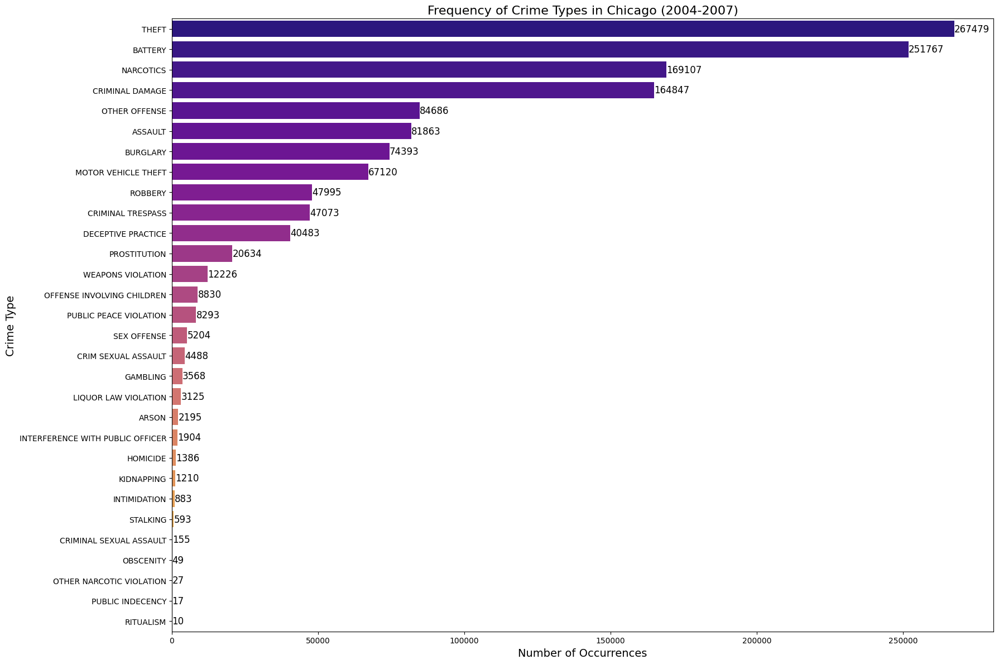

In [ ]:
#@title Frequency of Crime per Type (2004-2007)
plt.figure(figsize=(18, 12))  # Increase height to accommodate all crime types
all_crimes = data['Primary Type'].value_counts()  # Get frequency of all crime types
ax = sns.barplot(x=all_crimes.values, y=all_crimes.index, palette='plasma')

# Update title and axis labels
plt.title('Frequency of Crime Types in Chicago (2004-2007)', fontsize=16)
plt.xlabel('Number of Occurrences', fontsize=14)
plt.ylabel('Crime Type', fontsize=14)

# Add number labels to the top of each bar
for index, value in enumerate(all_crimes.values):
    ax.text(value + 50, index, f'{value}', va='center', fontsize=12)  # Adjust offset and font size

plt.tight_layout()
plt.show()

<ipython-input-11-1a0cb5f4b405>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=season_arrest_counts.index, y=season_arrest_counts.values, palette='pastel')


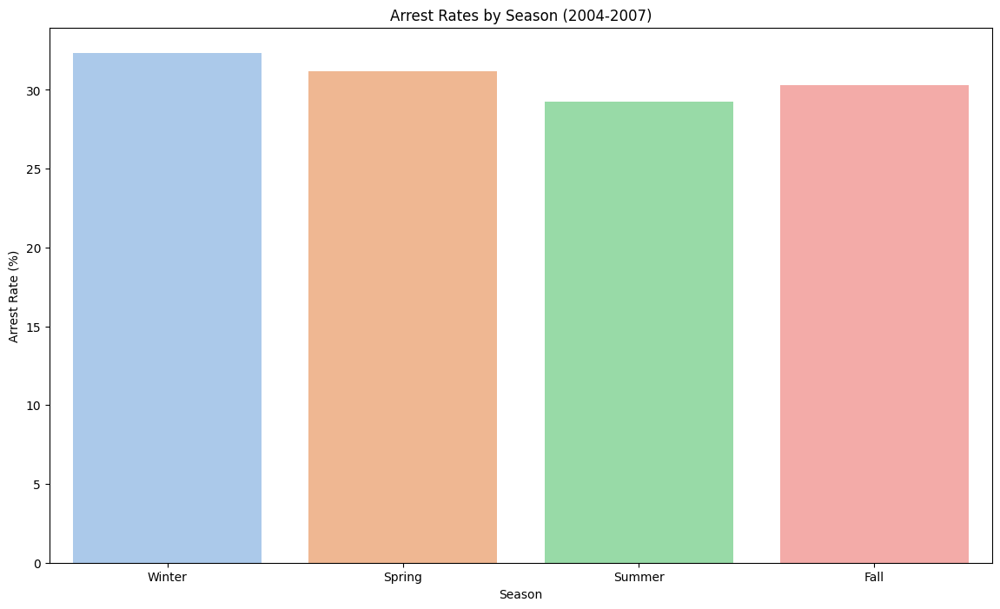

In [ ]:
#@title Arrest Rates by Season
if 'Season' not in data.columns:
    data['Date'] = pd.to_datetime(data['Date'])

    # Function categorize months to its associated season
    def get_season(month):
        if month in [12, 1, 2]:
            return 'Winter'
        elif month in [3, 4, 5]:
            return 'Spring'
        elif month in [6, 7, 8]:
            return 'Summer'
        elif month in [9, 10, 11]:
            return 'Fall'
    data['Season'] = data['Date'].dt.month.apply(get_season)

plt.figure(figsize=(14, 8))
season_arrest_counts = data.groupby('Season')['Arrest'].mean().reindex(['Winter', 'Spring', 'Summer', 'Fall']) * 100
sns.barplot(x=season_arrest_counts.index, y=season_arrest_counts.values, palette='pastel')
plt.title('Arrest Rates by Season (2004-2007)')
plt.ylabel('Arrest Rate (%)')
plt.xlabel('Season')
plt.show()

<ipython-input-51-44adf18f159d>:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  data['Date'] = pd.to_datetime(data['Date'])


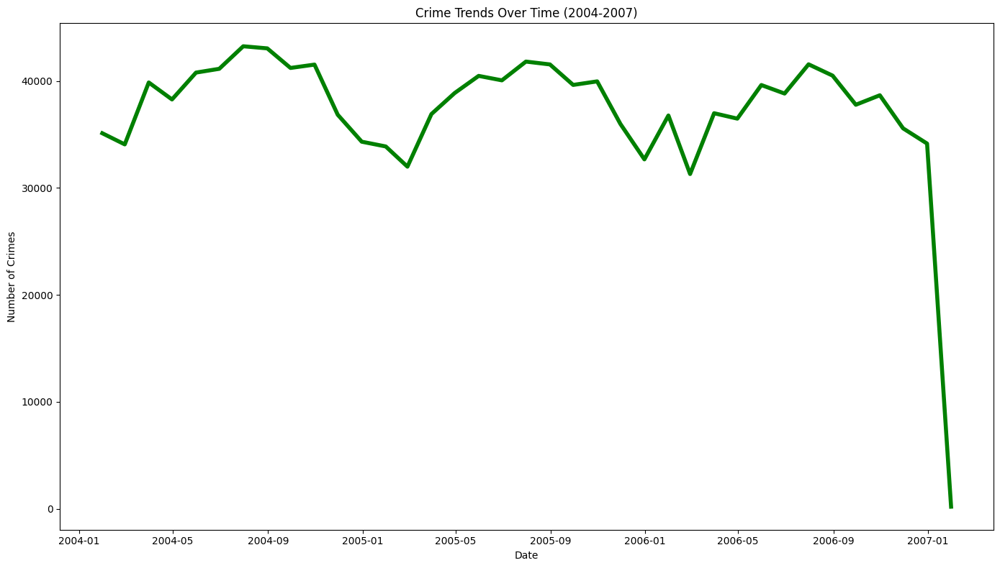

In [ ]:
#@title Crime Trends Over Time
data['Date'] = pd.to_datetime(data['Date'])

crime_trends = data.resample('ME', on='Date').size()
plt.figure(figsize=(14, 8))
plt.plot(crime_trends.index, crime_trends.values, color='green', linewidth=4)
plt.title('Crime Trends Over Time (2004-2007)')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.tight_layout()
plt.show()

In [ ]:
if 'Latitude' not in data.columns or 'Longitude' not in data.columns:
    raise ValueError("The dataset must contain 'Latitude' and 'Longitude' columns.")

data = data.dropna(subset=['Latitude', 'Longitude'])
map_center = [data['Latitude'].mean(), data['Longitude'].mean()]
crime_map = folium.Map(location=map_center, zoom_start=12)
heat_data = data[['Latitude', 'Longitude']].values.tolist()
HeatMap(heat_data, radius=15, blur=10).add_to(crime_map)
crime_map.save('crime_heatmap.html')
crime_map

<ipython-input-54-45d47af533c9>:2: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  crime_trends = crime_trends.asfreq('M')  # Ensure monthly frequency


                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                   29
Model:                 ARIMA(5, 1, 0)   Log Likelihood                -258.867
Date:                Wed, 12 Feb 2025   AIC                            529.735
Time:                        19:45:25   BIC                            537.728
Sample:                    01-31-2004   HQIC                           532.179
                         - 05-31-2006                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0440      0.133     -0.331      0.741      -0.305       0.217
ar.L2          0.2386      0.118      2.029      0.042       0.008       0.469
ar.L3         -0.0189      0.167     -0.114      0.9

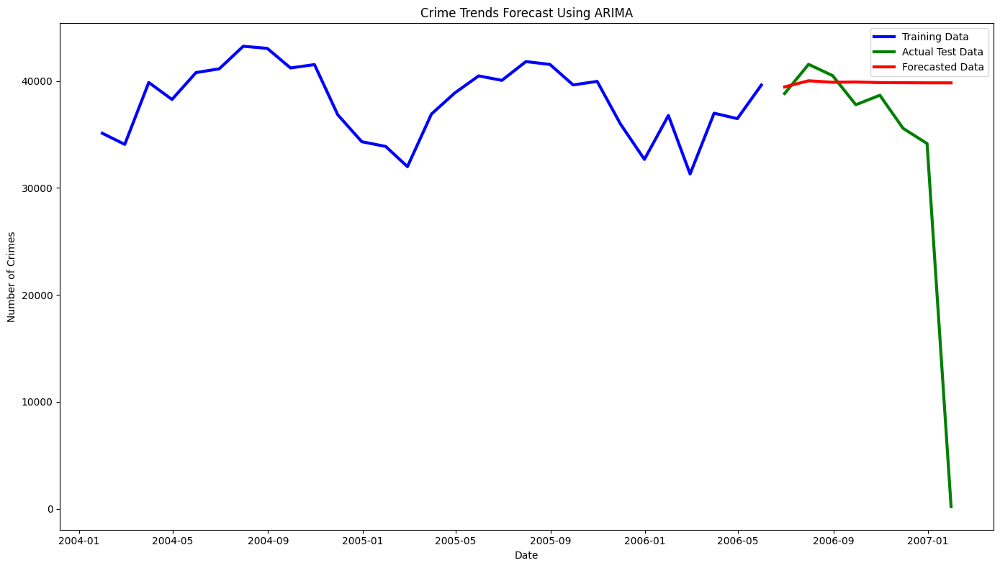

<ipython-input-54-45d47af533c9>:30: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  plt.plot(pd.date_range(start=crime_trends.index[-1], periods=future_steps+1, freq='M')[1:], future_forecast, label='Future Forecast', color='red', linewidth =3)


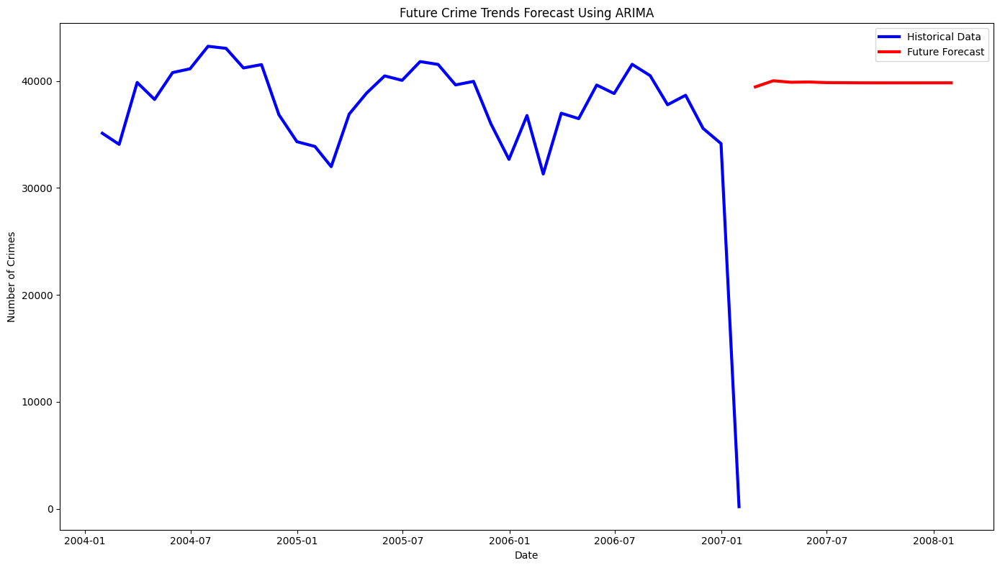

In [ ]:
#@title Forecasting with ARIMA Model
crime_trends = crime_trends.asfreq('M')  # Ensure monthly frequency
train_size = int(len(crime_trends) * 0.8)
train, test = crime_trends[:train_size], crime_trends[train_size:]
# Fit ARIMA model
model = ARIMA(train, order=(5, 1, 0))  # Example: ARIMA(5, 1, 0)
model_fit = model.fit()
print(model_fit.summary())

# Forecast for the test set
forecast = model_fit.forecast(steps=len(test))
mse = mean_squared_error(test, forecast)
print(f'Mean Squared Error: {mse}')
plt.figure(figsize=(14, 8))
plt.plot(train.index, train, label='Training Data', color='blue', linewidth = 3)
plt.plot(test.index, test, label='Actual Test Data', color='green', linewidth = 3)
plt.plot(test.index, forecast, label='Forecasted Data', color='red', linewidth = 3)
plt.title('Crime Trends Forecast Using ARIMA')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.legend()
plt.tight_layout()
plt.show()
future_steps = 12  # Forecast for the next 12 months
future_forecast = model_fit.forecast(steps=future_steps)

# Plot future forecast
plt.figure(figsize=(14, 8))
plt.plot(crime_trends.index, crime_trends, label='Historical Data', color='blue', linewidth = 3)
plt.plot(pd.date_range(start=crime_trends.index[-1], periods=future_steps+1, freq='M')[1:], future_forecast, label='Future Forecast', color='red', linewidth =3)
plt.title('Future Crime Trends Forecast Using ARIMA')
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.legend()
plt.tight_layout()
plt.show()